In [71]:
from mazeAgentUtils import * 
%load_ext autoreload
%autoreload 2


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
[autoreload of mazeAgentUtils failed: Traceback (most recent call last):
  File "/Users/tomgeorge/anaconda3/lib/python3.6/site-packages/IPython/extensions/autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "/Users/tomgeorge/anaconda3/lib/python3.6/site-packages/IPython/extensions/autoreload.py", line 394, in superreload
    module = reload(module)
  File "/Users/tomgeorge/anaconda3/lib/python3.6/imp.py", line 315, in reload
    return importlib.reload(module)
  File "/Users/tomgeorge/anaconda3/lib/python3.6/importlib/__init__.py", line 166, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 618, in _exec
  File "<frozen importlib._bootstrap_external>", line 674, in exec_module
  File "<frozen importlib._bootstrap_external>", line 781, in get_code
  File "<frozen importlib._bootstrap_external>", line 741, in source_to_code
  F

In [72]:
N=250
xcen = np.linspace(0,3,N+1)[:-1]
ycen = np.array([0.075]*N)
centres = np.vstack((xcen,ycen)).T
params = { 
          'mazeType'           : 'oneRoom',  #type of maze, define in getMaze() function
          'stateType'          : 'gaussian', #feature on which to TD learn (onehot, gaussian, gaussianCS, fourier, circles)
          'movementPolicy'     : 'randomWalk',  #movement policy (raudies, random walk, windows screensaver)
          'roomSize'           : 1,          #maze size scaling parameter, metres
          'dt'                 : 0.1,       #simulation time disretisation 
          'dx'                 : 0.01,       #space discretisation (for plotting, movement is continuous)
          'tau'                : 6,          #TD decay time, seconds
          'TDdx'               : 0.02,       #rough distance between TD learning updates, metres 
          'alpha'              : 0.01,       #TD learning rate 
          'nCells'             : N,       #how many features to use
          'cellFiringRate'     : 10,         #peak firing rate of a cell (middle of place field, preferred theta phase)
          'centres'            : None,       #array of receptive field positions. Overwrites nCells
          'speedScale'         : 0.16,       #movement speed scale, metres/second
          'rotSpeedScale'      : None,       #rotational speed scale, radians/second
          'initPos'            : None,       #initial position [x0, y0], metres
          'initDir'            : None,       #initial direction, unit vector
          'sigma'              : 0.02,        #feature cell width scale, relevant for  gaussin, gaussianCS, circles
          'placeCellThreshold' : 0,        #place cell threshold value (fraction of its maximum)
          'gridCellThreshold'  : 0,          #grid cell threshold value (fraction of its maximum)
          'doorsClosed'        : False,       #whether doors are opened or closed in multicompartment maze
          'tau_pre'            : 20e-3,      #rate potentiating trace decays
          'tau_post'           : 20e-3,      #rate depressing trace decays 
          'eta_pre'            : 0.01,       #learning rate for pre to post strengthening 
          'eta_post'           : 0.01,       #learning rate for post to pre weakening
          'a_pre'              : 1,          #per trace bump when cell spikes
          'a_post'             : 0.3,        #post trace bump when cell spikes
          'w_max'              : 20e-3       #max STDP weights
}


agent =  MazeAgent(params)
agent.extent
plotter = Visualiser(agent)
plotter.plotMazeStructure(save=True)
plotter.plotFeatureCells()

Setting parameters
Initialising
   making state/history dataframes
   initialising velocity, position and direction
   setting time/run counters
   making the maze walls
   discretising position for later plotting
   handling undefined parameters
   initialising basis features for learning
   checking basis cells aren't too close
     min seperation distanc:  10.0 cm
       929  overlapping pairs
       836  overlapping pairs
       847  overlapping pairs
       840  overlapping pairs
       892  overlapping pairs
       855  overlapping pairs
       837  overlapping pairs
       888  overlapping pairs
       868  overlapping pairs
       894  overlapping pairs
       894  overlapping pairs
     min seperation distanc:  9.0 cm
       665  overlapping pairs
       691  overlapping pairs
       682  overlapping pairs
       715  overlapping pairs
       691  overlapping pairs
       652  overlapping pairs
       639  overlapping pairs
       660  overlapping pairs
       680  overlapping

TypeError: plotFeatureCells() got an unexpected keyword argument 'save'

  0%|          | 0/600000 [00:00<?, ?it/s]

Calculating place and grid cells


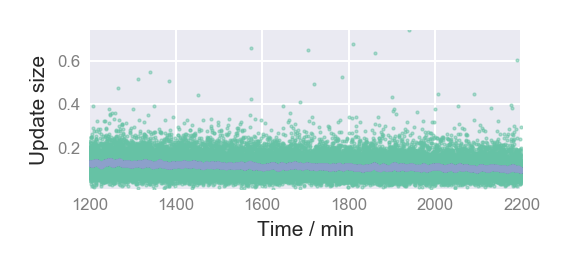

In [67]:
# agent.pos = np.array([0.5,0.5])
# agent.vel = np.array([1,0])
agent.runRat(trainTime=1000,STDPLearn=False,saveEvery=None)

/Users/tomgeorge/Documents/UCL/Rotation2_Barry/CompositionalMazes/mazeAgentUtils.py:1226: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.savefig(path+".pdf", dpi=400,tight_layout=tight_layout,transparent=transparent)


(<Figure size 3000x3000 with 36 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f8b1cfec4e0>)

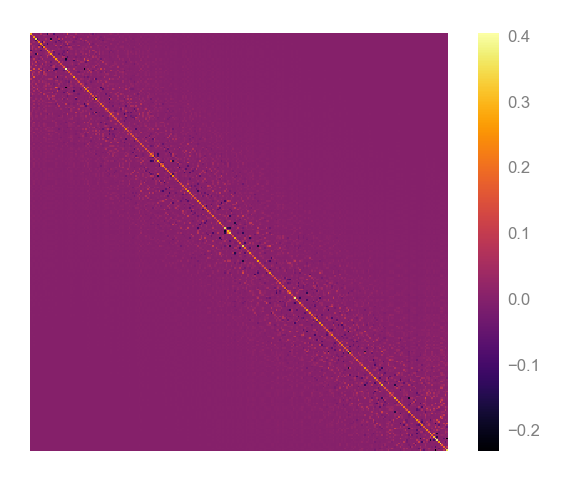

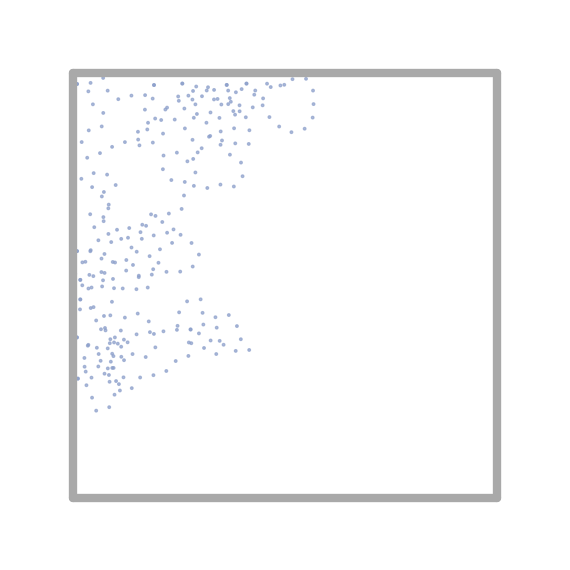

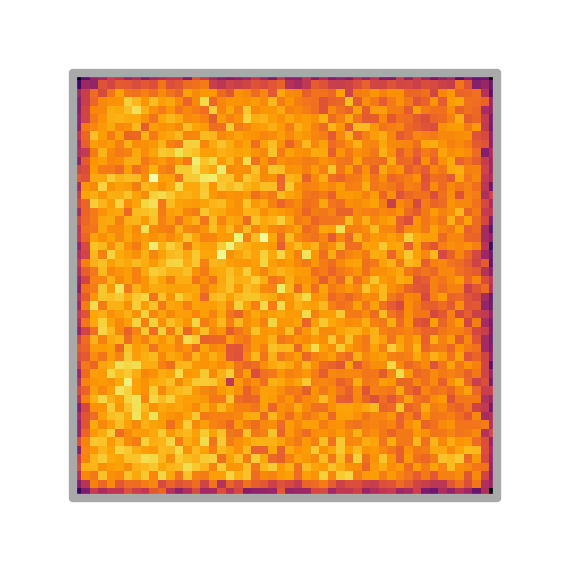

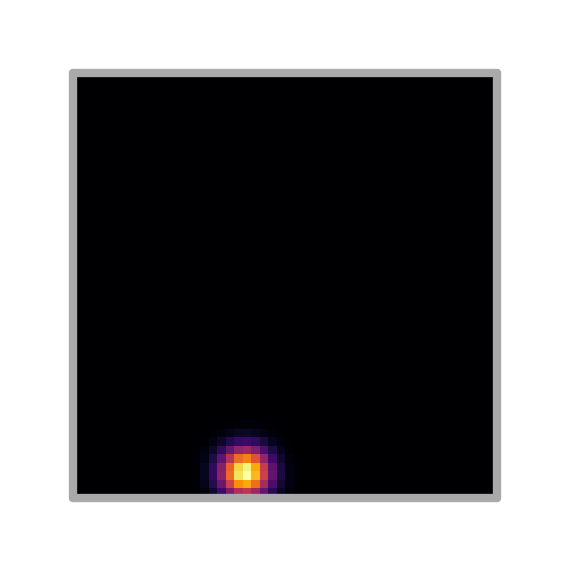

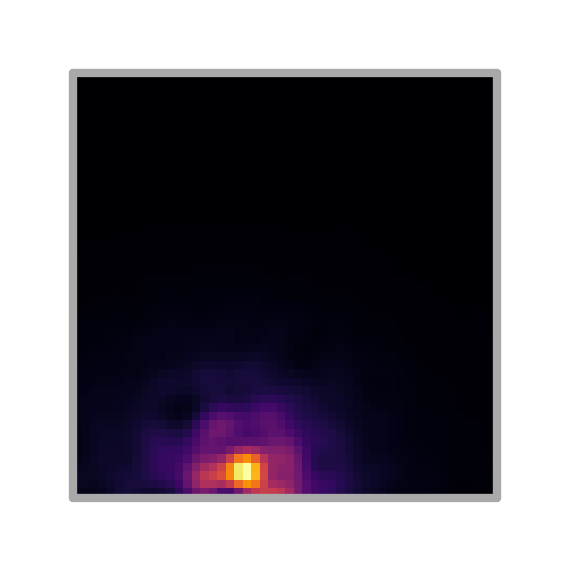

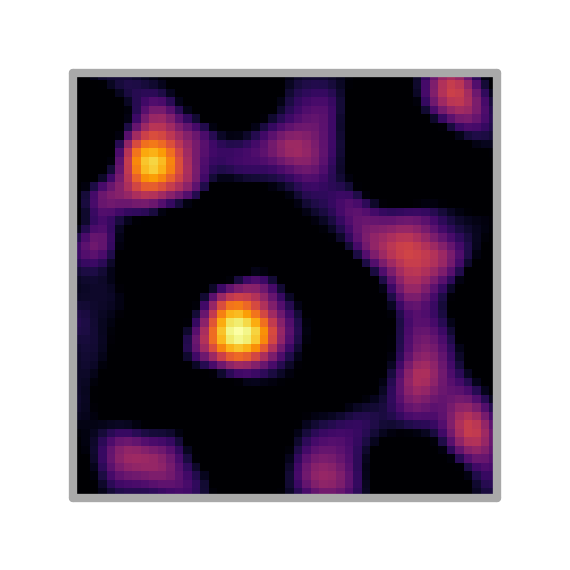

/Users/tomgeorge/anaconda3/lib/python3.6/site-packages/IPython/core/pylabtools.py:132: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


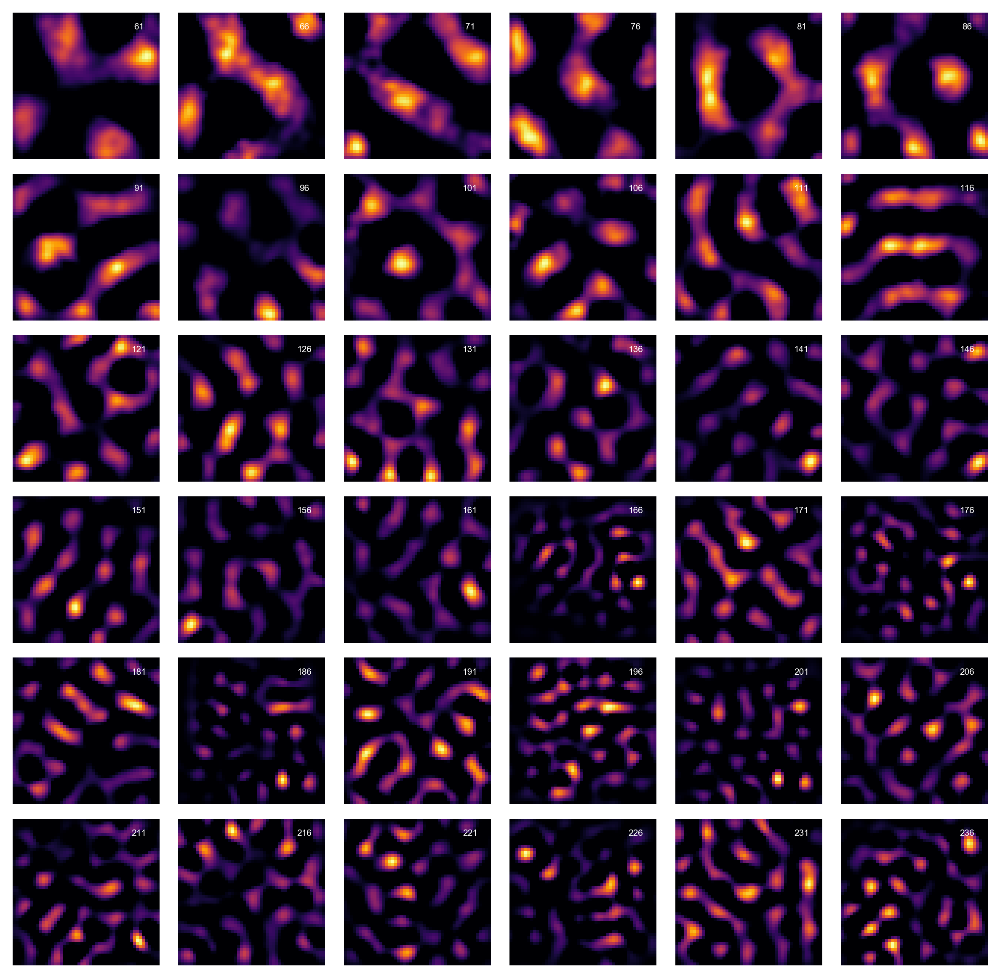

In [68]:
plotter = Visualiser(agent)

plotter.plotM()
# plotter.plotFeatureCells()

# plotter.plotPlaceFields()
plotter.plotTrajectory(starttime=(agent.t/60)-0.5,endtime=(agent.t/60))
plotter.plotHeatMap()

N_plot = 100
# plotter.plotReceptiveField(number=35)
plotter.plotPlaceField(number=N_plot,time=0)
plotter.plotPlaceField(number=N_plot)
plotter.plotGridField(number=N_plot)

# plotter.plotReceptiveField(number=50)

plotter.plotGridField(number='many')

# plotter.animateField(field='M',interval=200)
# plotter.animateField(field='place',number=-10,interval=200)



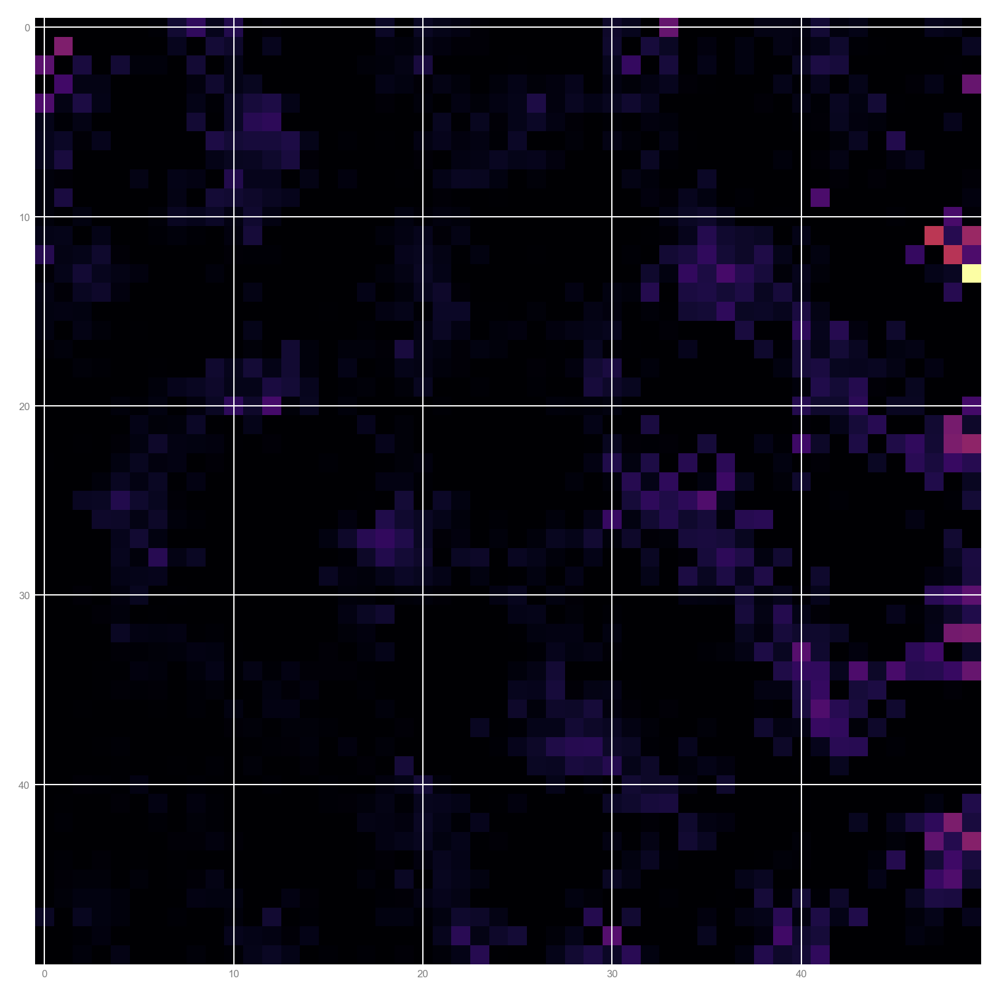

In [51]:
def sigmoid(x):
    return np.exp(x) / (np.exp(x) + np.exp(-x))
sigmoid(agent.gridFields)
plt.imshow(agent.gridFields[90])


In [7]:
# params = {}
params['hi'] = params.get('hi', 1)

In [8]:
params

{'hi': 0}

In [1]:
a= 1
b = {'a':0,'b':3,'c':4}
a = b.get('a',a)
a

0

In [4]:
for item in b:
    print(b[item])

0
3
4


In [13]:
import numpy as np 
np.min(np.random.randn(4,3,2)[...,])


IndexError: index 2 is out of bounds for axis 2 with size 2

In [15]:
a = 'hi'
a in ['hi ','bye','why']

False

In [16]:
a = [1,2]
a.shape

AttributeError: 'list' object has no attribute 'shape'

In [12]:
a = get(b,1)

NameError: name 'get' is not defined

In [17]:
a = (abc or 'a')
 

NameError: name 'abc' is not defined

1

In [42]:
a = {'a':1,'b':2}


SyntaxError: invalid syntax (<ipython-input-31-d9bf5f0e14f7>, line 1)

In [34]:
class hi():
    def __init__(self):
        pass
a = hi()

In [41]:
al = a.get('a',None); al=(al 

AttributeError: 'hi' object has no attribute 'get'

In [54]:
a = (2 or 1)

In [55]:
a

2

In [75]:
defaultParams = { 
          'mazeType'           : 'oneRoom',
          'stateType'          : 'gaussian',
          'movementPolicy'     : 'randomWalk',
          'roomSize'           : 1,
          'dt'                 : 0.01,
          'dx'                 : 0.01,     
          'tau'                : 2,
          'TDdx'               : 0.02,
          'nCells'             : None,
          'velScale'           : 0.16,
          'rotVelScale'        : None,
          'initPos'            : None,  
          'initDir'            : None,
          'sigma'              : 0.3,
          'placeCellThreshold' : 0.5, 
          'gridCellThreshold'  : 0,
          'doorsClosed'        : True}
globals().update(defaultParams)

In [76]:
class A:
    def __init__(self):
        locals().update({'a':1,'b':2})

In [77]:
a = A()

In [78]:
a.a

AttributeError: 'A' object has no attribute 'a'

In [96]:
a = [1,2]


True

In [137]:
a = np.array([1,2,3,4,5])
np.random.shuffle(a)

In [136]:
b

In [24]:
a = 1
(type(a) is int) or (type(a) is float)

True

In [27]:
'a'.isnumeric()

False

In [30]:
import numbers 
isinstance(5.2, numbers.Number)

True

In [2]:
s = 0
for i in range(100000000000):
    try:
        s += 1
    except KeyboardInterrupt:
        print(s)
        break

15219313


In [32]:
alpha_

1

In [8]:
('C0' or 'C' + str(4))

'C0'

In [15]:
agent.gridFields[:,0,0]


array([3.64003046e-02, 0.00000000e+00, 4.91751333e-04, 0.00000000e+00,
       0.00000000e+00, 3.59554093e-03, 0.00000000e+00, 1.00303050e-02,
       0.00000000e+00, 6.80400973e-03, 6.02063232e-03, 9.61915870e-04,
       5.17490263e-03, 0.00000000e+00, 1.44259667e-04, 2.18384462e-03,
       0.00000000e+00, 1.45531964e-03, 1.15706092e-04, 0.00000000e+00,
       0.00000000e+00, 1.00150738e-04, 1.24641051e-04, 0.00000000e+00,
       2.67600445e-04, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 8.10780554e-06, 0.00000000e+00, 2.53091584e-05,
       2.27798793e-05, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 1.00724658e-05, 0.00000000e+00, 2.40063105e-06,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       2.19322610e-06, 3.18612448e-06, 0.00000000e+00, 7.75569778e-07,
       4.48496304e-07, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       4.42659643e-07, 1.24354510e-07, 0.00000000e+00, 4.26476688e-07,
      

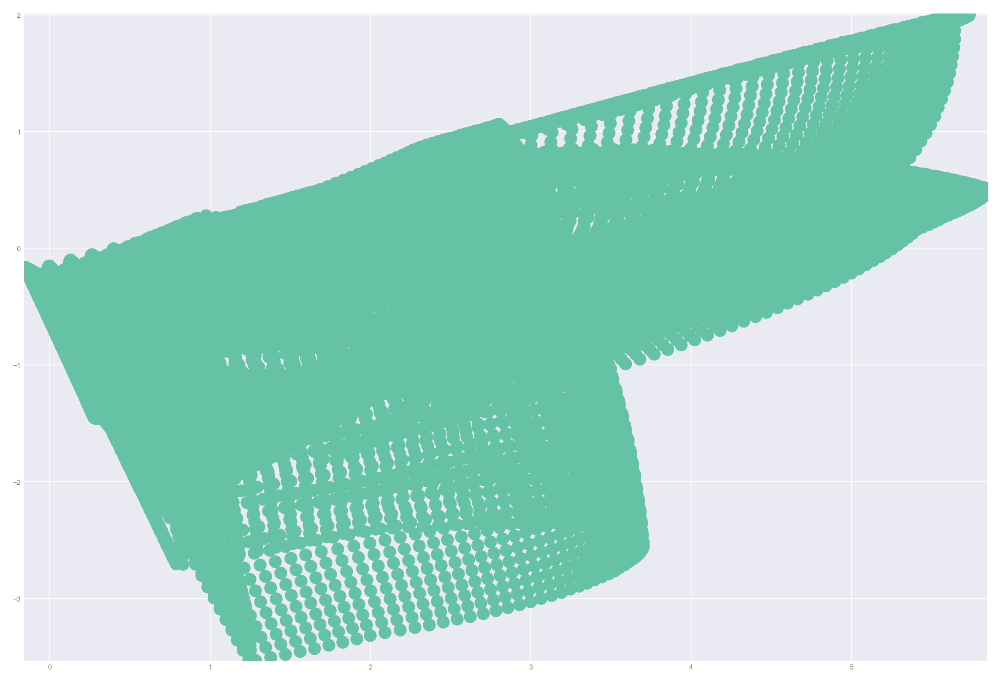

In [57]:
grids = agent.gridFields.reshape(agent.gridFields.shape[0],-1)
gridcov = np.matmul(grids[7:16],grids[7:16].T)
eigs = np.real(np.linalg.eig(gridcov)[1])[:,:6]
project = np.matmul(grids[7:16].T,eigs)
project = (project - np.mean(project))/np.std(project)
plt.scatter(project[:,0],project[:,1])

In [60]:
import umap
reducer = umap.UMAP(n_components=3, n_neighbors=1000)
embedding = reducer.fit_transform(project)
embedding.shape

(40000, 3)

/Users/tomgeorge/anaconda3/lib/python3.6/site-packages/IPython/core/pylabtools.py:132: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


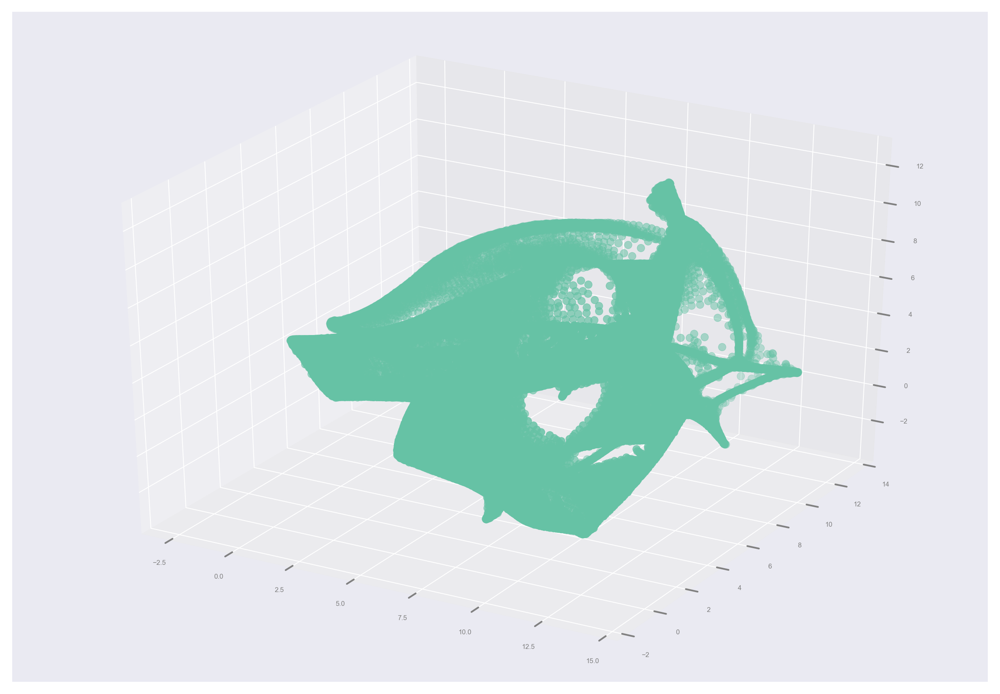

In [61]:
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = Axes3D(fig)
ax.scatter(embedding[:,0],embedding[:,1],embedding[:,2])